Test size:  (88457, 162)
Train size:  (5792, 162)
Train frac:  6.145423293615847
vig  tr:  (5792, 35)
vig  test:  (88457, 35)
Test size:  (88457, 162)
Train size:  (5792, 162)
Train frac:  6.145423293615847
vig  tr:  (5792, 135)
vig  test:  (88457, 135)
Test size:  (88457, 162)
Train size:  (5792, 162)
Train frac:  6.145423293615847
vig  tr:  (5792, 130)
vig  test:  (88457, 130)
random dis n est
Test size:  (88457, 162)
Train size:  (5792, 162)
Train frac:  6.145423293615847
vig  tr:  (5792, 85)
vig  test:  (88457, 85)


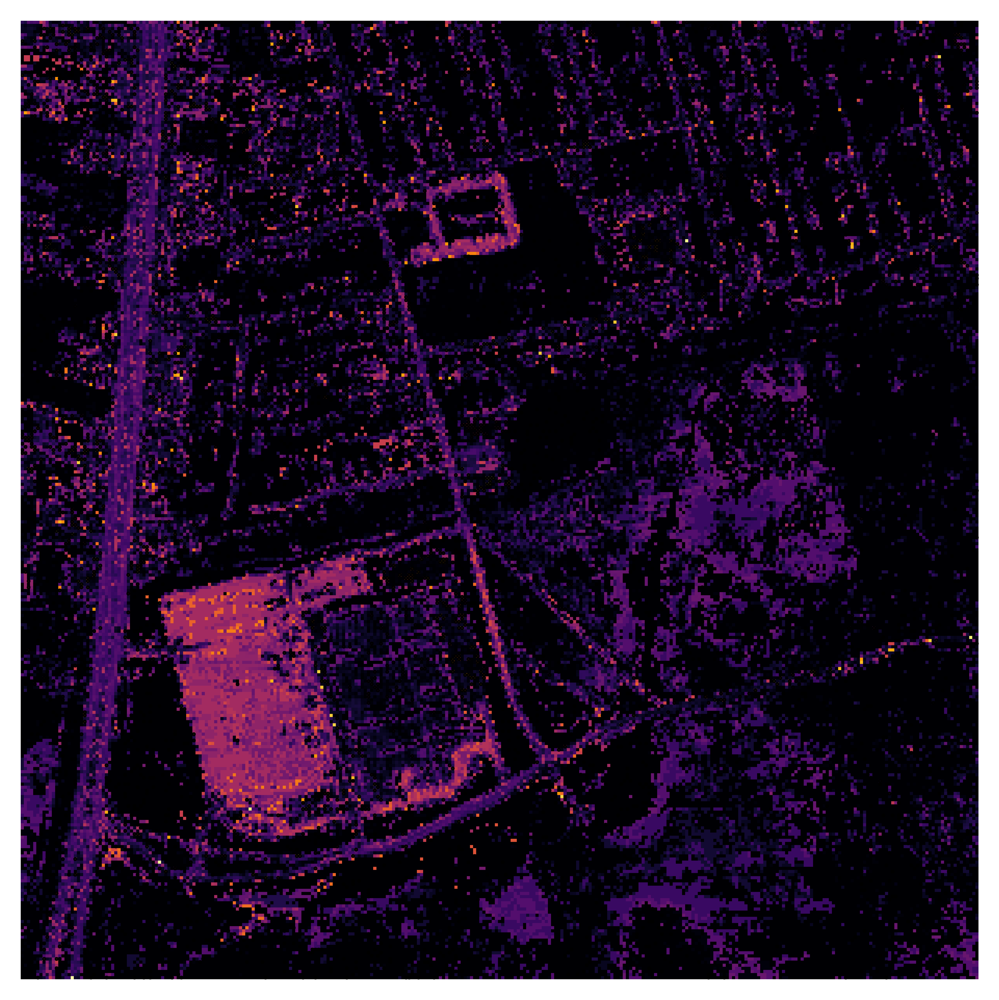

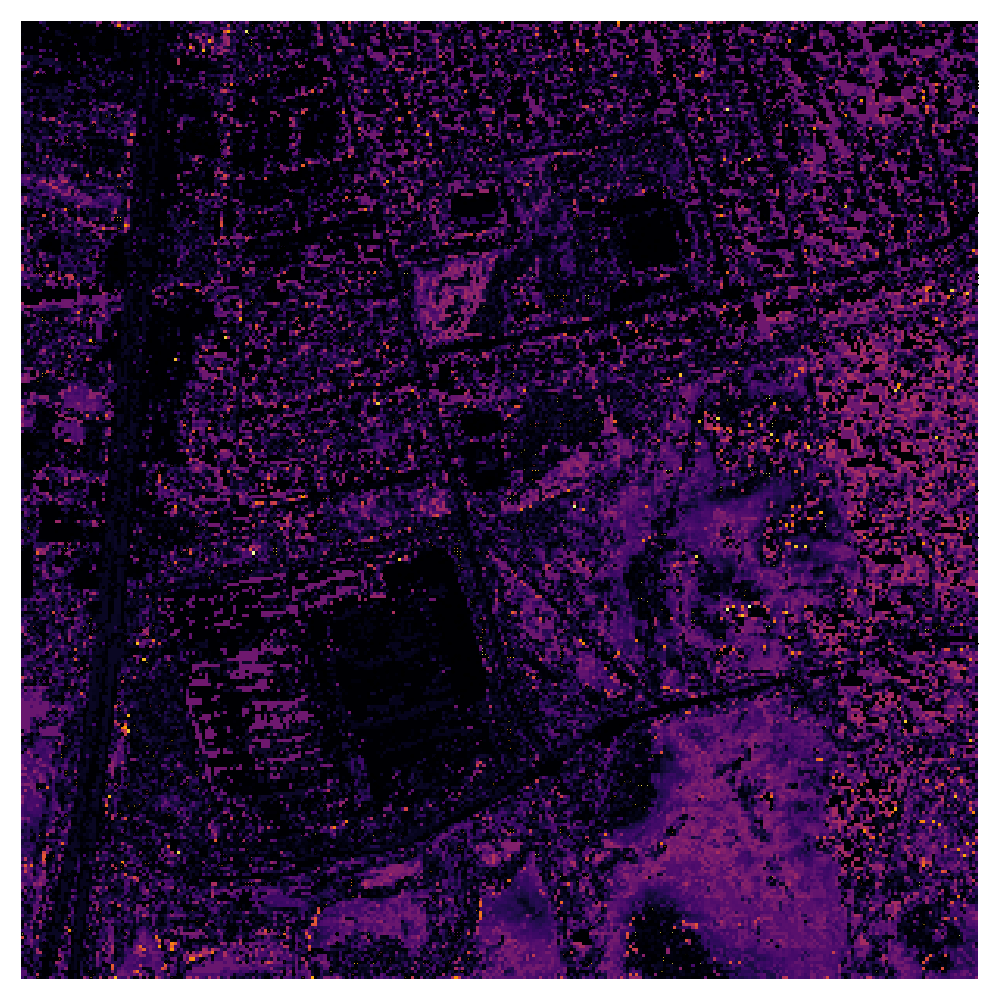

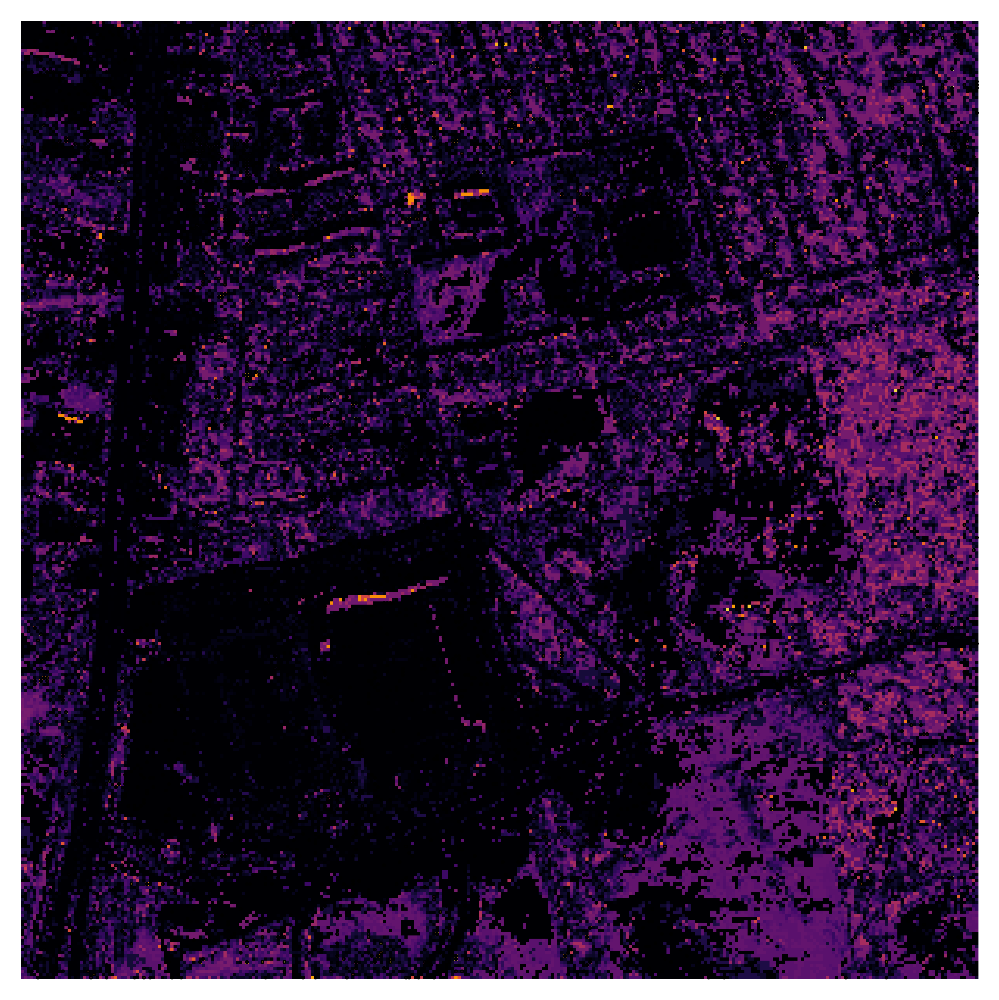

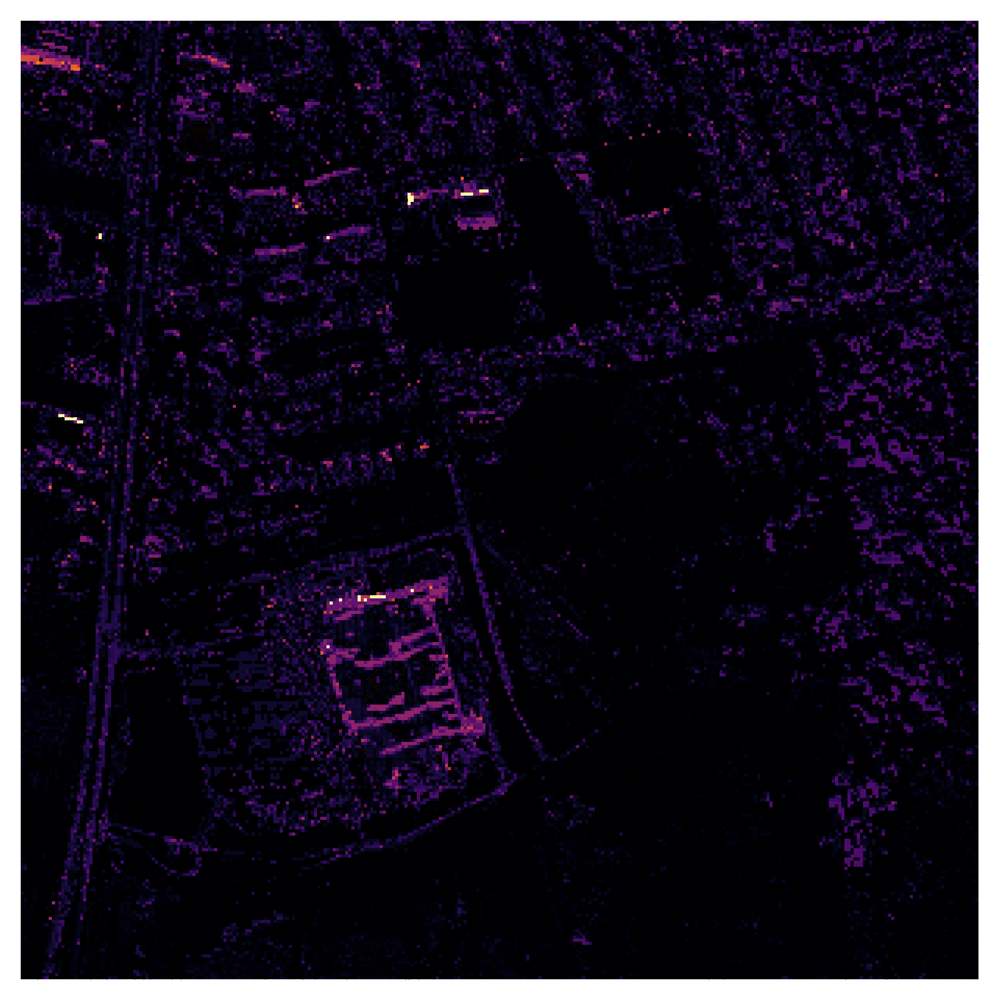

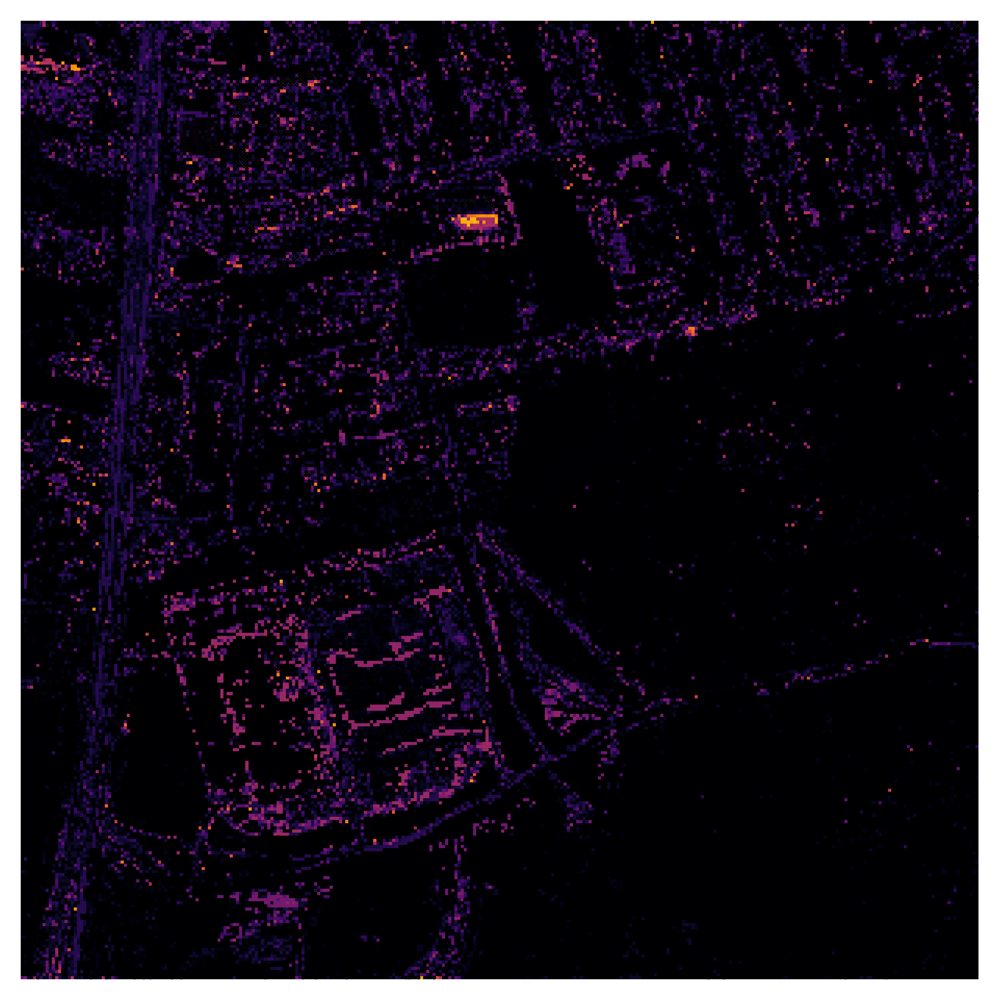

...

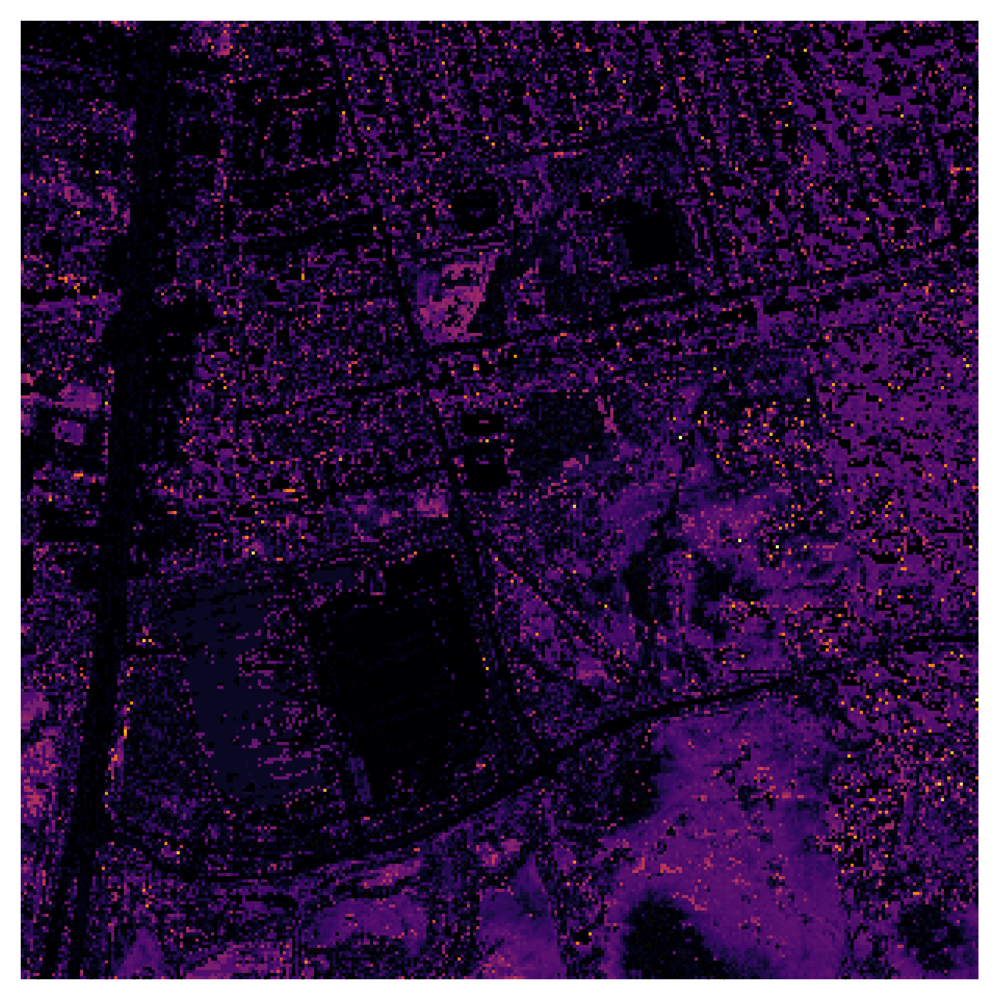

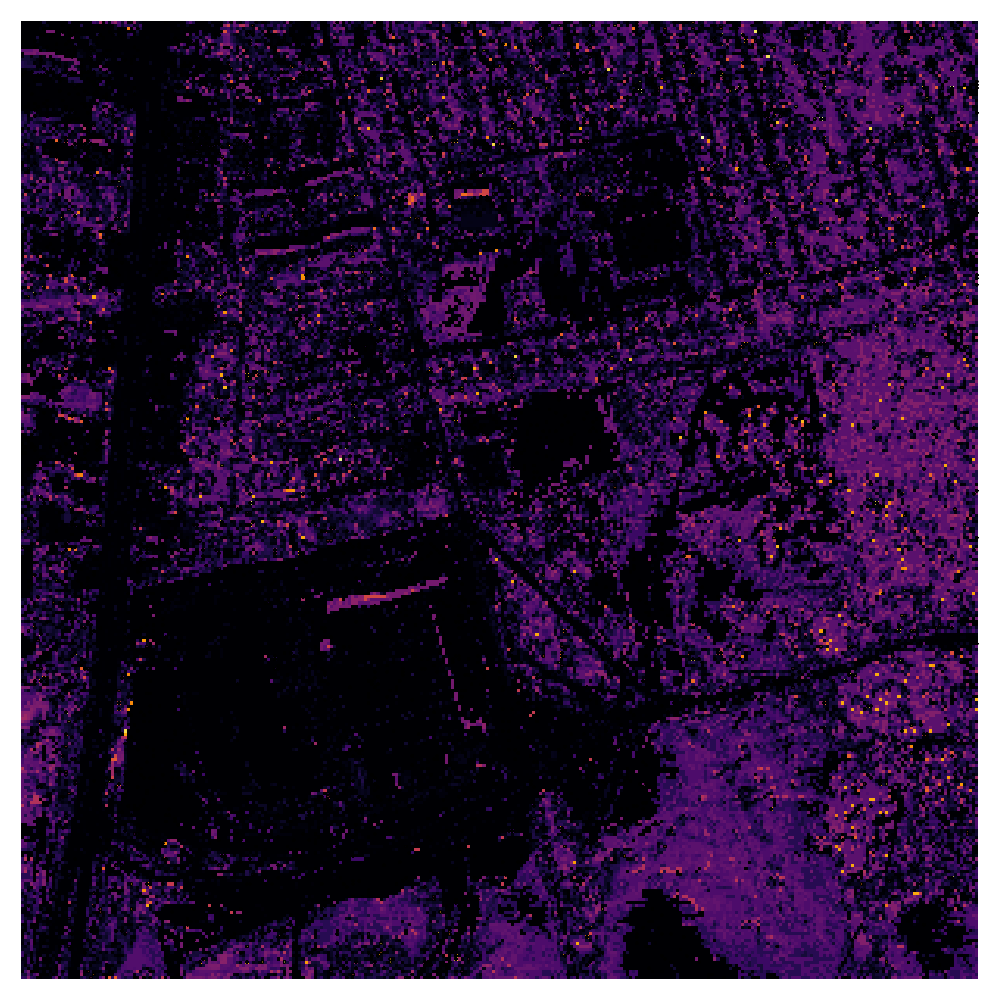

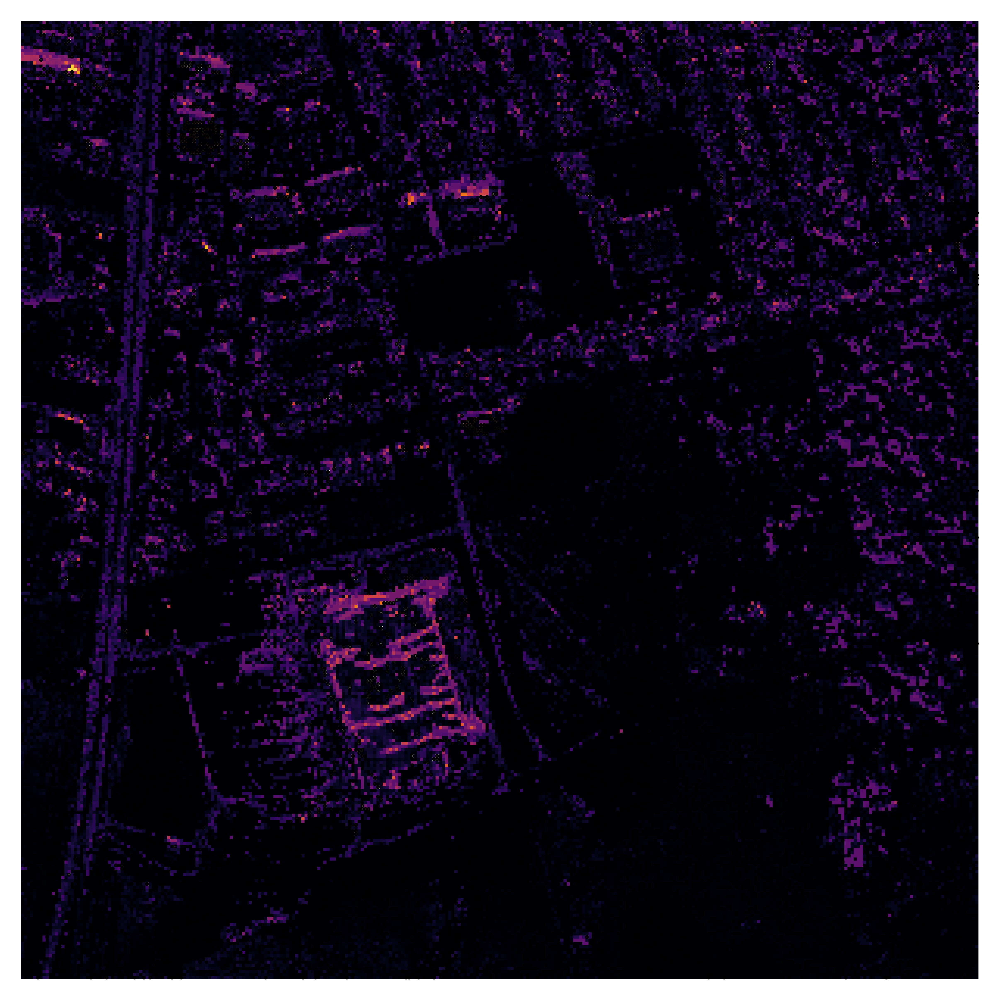

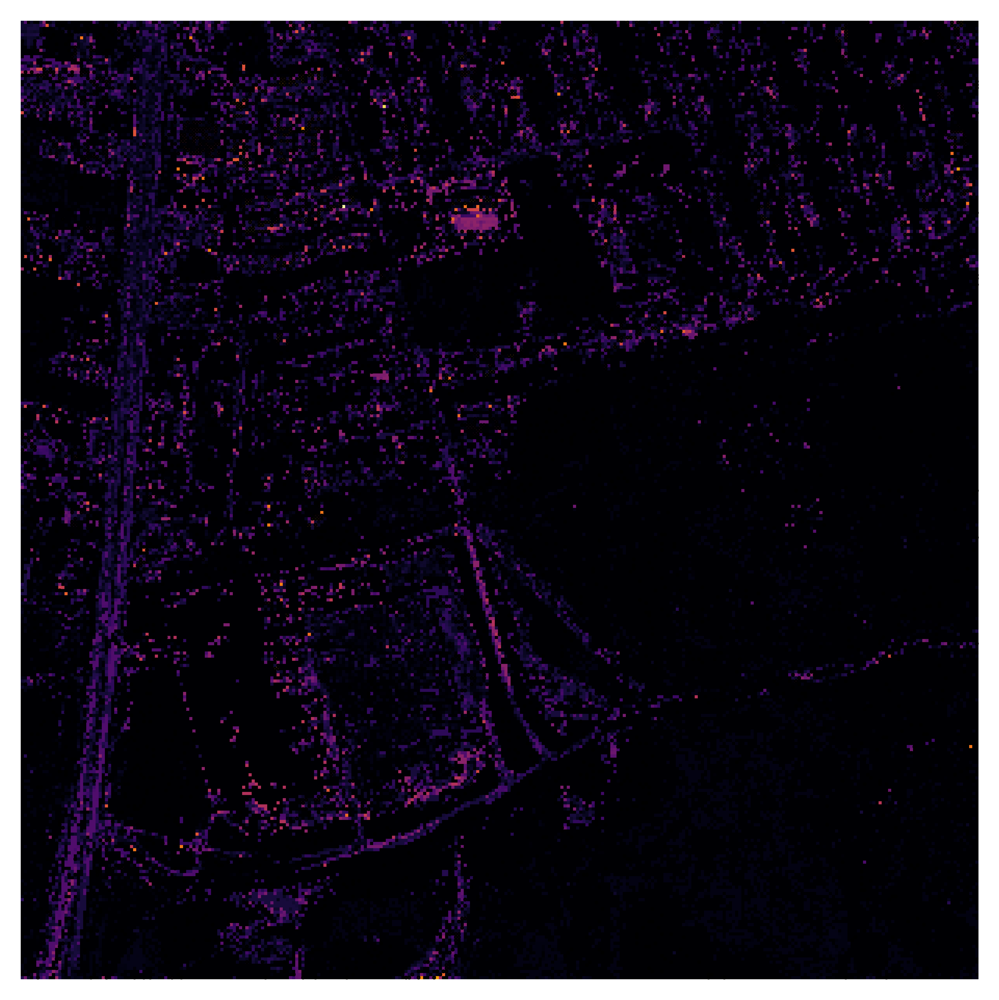

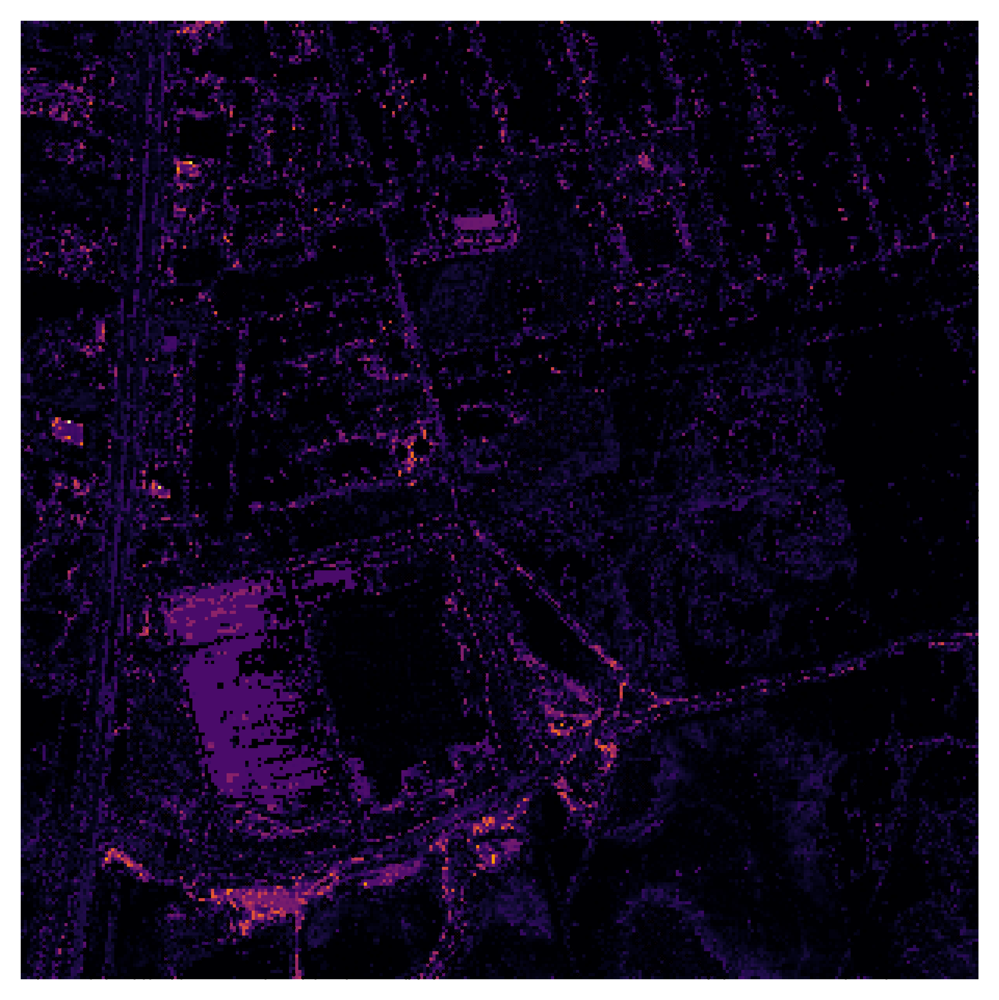

In [1]:
from scipy.stats import wilcoxon
import pandas as pd
import numpy as np


N_ATTRIBUTES = 162
models = ["vig_ours_rf", "mi", "random", "bombs"]
diffs = {}
band_indices = {}
for model in models:
    diffs[model] = []

    results = {}
    for metric_name in ["mse", "mae", "expl_var", "r2"]:
        for class_index in range(6):
            results[f"{metric_name}_class_{class_index}"] = {}
        results[f"{metric_name}_mean"] = {}
    results["time"] = {}

    for n_clusters in list(range(5, N_ATTRIBUTES, 5)):
        dfs = []
        for random_state in range(20):
            df = pd.read_csv(
                f"C:\\Users\\luktu\\Downloads\\gawll (1)\\results_test_frac_band_sel_estimators_4_{model}\\n_clusters-{n_clusters},test_size-band_sel,random_state-{random_state}.csv"
            )
            dfs.append(df)
        df = pd.concat(dfs, ignore_index=True).to_dict(orient="list")
        for k, v in df.items():
            results[k][f"bands_{n_clusters}"] = v

    mae_means = results["mae_mean"]
    mae_means = {k: np.mean(v) for k, v in mae_means.items()}
    min_element = min(mae_means.items(), key=lambda x: x[1])
    band_index, band_mae = min_element

    from runner_reg import run

    test_indices, y_pred= run(
        select_bands=True,
        n_clusters=int(band_index.replace("bands_", "")),
        n_estimators=4,
        random_state=0,model=model
    )

    data = np.load("others/urban.npy")
    data_re = data.reshape(-1, data.shape[-1])
    num_samples = data_re.shape[0]

    pred = np.empty(shape=(num_samples, 6))
    pred[test_indices] = y_pred

    train_indices = np.setdiff1d(np.arange(num_samples), test_indices)
    pred[train_indices] = -1
    pred = pred.reshape((*data.shape[:2], 6))

    pred_mask = pred.copy()
    pred_masks = []

    for i in range(6):
        pred_masks.append(pred[..., i] == -1)
    pred = pred.reshape(-1, 6)
    pred[train_indices] = 0
    pred = pred.reshape((*data.shape[:2], 6))
    gt = np.load("others/urban_gt.npy").T.reshape(-1, 6)
    gt = gt.reshape((*data.shape[:2], 6))
    for target_index in range(6):
        diff = np.abs(gt[..., target_index] - pred[..., target_index])
        diffs[model].append(diff)
    band_indices[model] = int(band_index.replace("bands_", ""))
target_stat = []
for target_index in range(6):
    data = np.asarray(diffs[m][target_index] for m in models)
    min_, max_ = data.min(), data.max()
    target_stat.append((min_, max_))

import matplotlib.pyplot as plt
for model in models:
    for target_index in range(6):
        # cmap = plt.get_cmap('viridis')
        # cmap_colors = cmap(np.arange(cmap.N))
        # cmap_colors[2] = [1, 0, 0, 1]  # RGBA values for white
        # custom_cmap = LinearSegmentedColormap.from_list('custom_cmap', cmap_colors, cmap.N)
        diff_to_show = diffs[model][target_index]
        diff_to_show = (diff_to_show - 0) / (1 - 0)
        # Create a larger figure with increased DPI
        fig, ax = plt.subplots(figsize=(6, 6), dpi=1000)
        # target_pred__ = (target_pred__ - target_pred__.min()) / (
        #     target_pred__.max() - target_pred__.min()
        # )
        # Display the normalized image
        img = ax.imshow(diff_to_show, cmap='inferno')
        ax.scatter(pred_masks[target_index].nonzero()[1], 
                    pred_masks[target_index].nonzero()[0], c='black', s=0.1,marker='s')
        # Remove white margins
        ax.set_axis_off()
        # fig.colorbar(img, ax=ax)
        # Save the plot without margins
        plt.savefig(
            f"model_{model}_bands_number_{band_indices[model]}_target_class_{target_index}_diff.pdf",
            bbox_inches="tight",
            pad_inches=0,
        )
        plt.show()

        plt.close()
